In [1]:
!pip install boto3 s3fs pandas scikit-learn matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 201.0/201.0 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.3/87.3 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.3/14.3 MB 55.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.0/88.0 kB 4.3 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 2.0.1
    Uninstalling wrapt-2.0.1:
      Successfully uninstalled wrapt-2.0.1
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2025.3.0
    Uninstalling fsspec-2025.3.0:
      Successfully uninstalled fsspec-2025.3.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datasets 4.0.0 requires fsspec[http]<=2025.

In [2]:
import getpass
import os

# Securely prompt for credentials
aws_access_key_id = getpass.getpass('Enter AWS Access Key ID: ')
aws_secret_access_key = getpass.getpass('Enter AWS Secret Access Key: ')
region_name = input('Enter AWS Region (e.g., us-east-1): ')

S3_PATH = 's3://glue-bucket-gvd-fp/gold/trafico_dia/'

Enter AWS Access Key ID: ··········
Enter AWS Secret Access Key: ··········
Enter AWS Region (e.g., us-east-1): us-east-1


In [3]:
import pandas as pd

print(f"Reading data from {S3_PATH}...")

try:
    df = pd.read_parquet(
        S3_PATH,
        storage_options={
            'key': aws_access_key_id,
            'secret': aws_secret_access_key,
            'client_kwargs': {'region_name': region_name}
        }
    )
    print("Data loaded successfully!")
    print(f"Shape: {df.shape}")
    display(df.head())
except Exception as e:
    print("Error reading data:", e)
    print("Double check your S3 path and permissions.")

Reading data from s3://glue-bucket-gvd-fp/gold/trafico_dia/...
Data loaded successfully!
Shape: (212472, 12)


,id,traffic_h01,traffic_h07,traffic_h09,traffic_h11,traffic_h13,traffic_h15,traffic_h17,traffic_h19,traffic_h21,traffic_h23,traffic_date
0,613,0.125000,0.125000,0.0,0.0,0.206308,0.125000,0.204676,0.125,0.125,0.125000,2024-06-03
1,877,0.125000,0.125000,0.0,0.0,0.125000,0.125000,0.125000,0.125,0.125,0.125000,2024-06-03
2,818,0.125000,0.125000,0.0,0.0,0.125000,0.125000,0.125000,0.125,0.125,0.125000,2024-06-03
3,793,0.483382,0.125000,0.0,0.0,0.125000,0.412797,0.431995,0.125,0.125,0.362047,2024-06-03
4,814,0.125000,0.287362,0.0,0.0,0.125000,0.125000,0.340065,0.125,0.125,0.125000,2024-06-03


In [9]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# 1. Filter only the traffic columns for the model
traffic_cols = [c for c in df.columns if 'traffic_h' in c]
X = df[traffic_cols]

# 2. Handle missing values (just in case)
X = X.fillna(0)

# 3. Scale the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 4. Run K-Means
k = 3
kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
df['cluster_group'] = kmeans.fit_predict(X_scaled)

print("Clustering complete.")
print("\nLocations per Cluster:")
print(df['cluster_group'].value_counts())

Clustering complete.

Locations per Cluster:
cluster_group
0    128316
2     74315
1      9841
Name: count, dtype: int64


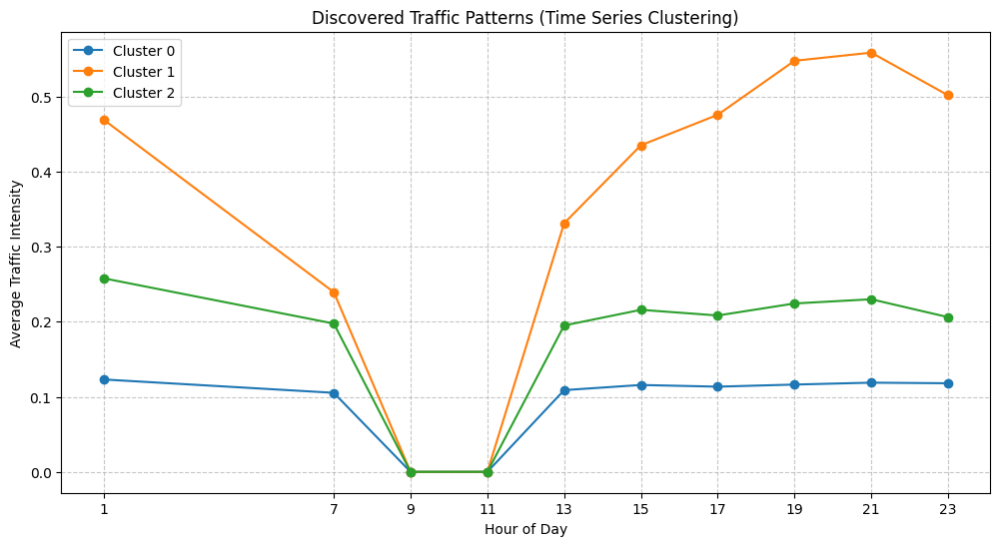

In [10]:
cluster_centers = scaler.inverse_transform(kmeans.cluster_centers_)

plt.figure(figsize=(12, 6))
hours = [int(col.replace('traffic_h', '')) for col in traffic_cols]

for i in range(k):
    plt.plot(hours, cluster_centers[i], marker='o', label=f'Cluster {i}')

plt.title('Discovered Traffic Patterns (Time Series Clustering)')
plt.xlabel('Hour of Day')
plt.ylabel('Average Traffic Intensity')
plt.xticks(hours)
plt.grid(True, linestyle='--', alpha=0.7)
plt.legend()
plt.show()

In [ ]:
# Set your locations CSV path from your S3 bucket
LOCATIONS_PATH = 's3://glue-bucket-example-name/bronze/catalogos/locationPoints.csv'

print("Reading Location Data...")
df_loc = pd.read_csv(
    LOCATIONS_PATH,
    encoding='latin-1',
    storage_options={
        'key': aws_access_key_id,
        'secret': aws_secret_access_key,
        'client_kwargs': {'region_name': region_name}
    }
)

# Clean data
df_loc['Coordx'] = df_loc['Coordx'].astype(str).str.replace(r'[^\d.-]', '', regex=True).astype(float)
df_loc['Coordy'] = df_loc['Coordy'].astype(str).str.replace(r'[^\d.-]', '', regex=True).astype(float)

# Ensure ID is the same type for merging
df_loc['id'] = df_loc['id'].astype(str)
df['id'] = df['id'].astype(str)

print("Locations loaded and cleaned.")

# Merge on 'id'
df_map = pd.merge(df, df_loc, on='id', how='inner')

# Force cluster_group to be a string (categorical) for different colours
df_map['cluster_group'] = df_map['cluster_group'].astype(str)

Reading Location Data...
Locations loaded and cleaned.


In [12]:
import plotly.express as px

fig = px.scatter_mapbox(
    df_map,
    lat="Coordy",
    lon="Coordx",
    color="cluster_group",
    hover_name="id",
    hover_data=["traffic_date"],
    zoom=10,
    height=600,
    title="Traffic Pattern Clusters",

    mapbox_style="carto-positron"
)

fig.update_traces(marker=dict(size=9, opacity=0.8))
fig.show()

In [14]:
traffic_columns = [col for col in df_map.columns if 'traffic_h' in col]
hover_cols = ['traffic_date'] + traffic_columns

df_map['cluster_label'] = df_map['cluster_group'].astype(str)

fig = px.scatter_mapbox(
    df_map,
    lat="Coordy",
    lon="Coordx",
    color="cluster_label",
    hover_name="id",
    hover_data=hover_cols,
    zoom=10,
    title="Distribución Geográfica de los Patrones de Tráfico",

    mapbox_style="open-street-map"
)

fig.update_traces(marker=dict(size=8, opacity=0.8))

fig.show()